<p style="text-align: center; font-size: 24px; font-weight: bold;">
     Distribution Network Analysis: Capacity Planning for Electric Vehicle (EV) Adoption
</p>


Distribution Network Analysis in the energy industry refers to the process of studying and evaluating the electrical distribution networks that deliver electricity from high-voltage transmission lines to end-users, such as homes, businesses, and industrial facilities. This analysis becomes even more critical with the rise of EVs, as it transforms the energy landscape.

## AIM OF THE PROJECT

The project aims to achieve the following objectives:

- Assess Network Capacity: Conduct a comprehensive analysis of the distribution network's current capacity to handle increased load from EV charging stations.

- Identify Bottlenecks: Identify potential bottlenecks and vulnerabilities within the distribution network that could hinder reliable electricity delivery to EV charging stations.

- Optimize Network Upgrades: Develop a data-driven strategy for network upgrades that maximizes efficiency, minimizes costs, and ensures grid reliability.

## Project Scope

- Exploratory Data Analysis: Conduct EDA to gain insights into electricity consumption patterns and network performance. 
- Capacity Assessment: Utilize historical data to assess the current distribution network's capacity and identify areas with high demand growth. Network Optimization: Utilize optimization algorithms to identify cost-effective network upgrades that address capacity shortfalls.
- Reporting and Recommendations: Present findings, including capacity assessments and upgrade recommendations, to the executive team for decision-making. Exploratory Data Analysis: Explore the data to understand its characteristics and discover patterns. 
- Data Transformation: Prepare the data for analysis by transforming, encoding, or normalizing it. 
- Data Analysis: Analyze data to understand pattern in order to generate insights that will be visualized. 
- Data Visualization: Create visual representations to communicate insights effectively. Interpretation and Insight Generation: Extract meaningful insights and interpret the results.

## DATA WRANGLING

In [72]:
#IMPORTING NECESSARY LIBRARIES
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
import geodatasets
import folium

In [105]:
#CHECKING THE CONTENT OF THE DATASET
dist=pd.read_csv(r"C:\Users\TOMORI\Documents\braktom\New folder (2)\ev_distribution_dataset.csv")
dist.head()

,Timestamp,Geographical_Area,Customer_Type,Electricity_Consumption (kWh),EV_Charging_Station_Location,EV_Charging_Station_Specifications,EV_Type,Charging_Habit,Number_of_EVs,Substation_ID
0,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907
1,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907
2,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907
3,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907
4,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907


In [106]:
#SPLITING THE EV CHARGING STATION LOCATION INTO LONGITUDE AND LATITUDE
dist[['Latitude', 'Longitude']] = dist['EV_Charging_Station_Location'].str.replace("[()]", "", regex=True).str.split(", ", expand=True)

#DROPPING THE EV CHARGING STATION COLUMN
#dist.drop(columns=["EV_Charging_Station_Location"], inplace=True)

#CHANGING THE DATA TYPE TO FLOAT
dist[['Latitude', 'Longitude']]=dist[['Latitude', 'Longitude']].astype(float)
dist.head()

,Timestamp,Geographical_Area,Customer_Type,Electricity_Consumption (kWh),EV_Charging_Station_Location,EV_Charging_Station_Specifications,EV_Type,Charging_Habit,Number_of_EVs,Substation_ID,Latitude,Longitude
0,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964
1,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907,48.447827,-71.988591
2,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964
3,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907,48.447827,-71.988591
4,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964


In [107]:
#CHECKING THE DATASET INFO
dist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 12 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Timestamp                           500 non-null    object 
 1   Geographical_Area                   500 non-null    object 
 2   Customer_Type                       500 non-null    object 
 3   Electricity_Consumption (kWh)       500 non-null    float64
 4   EV_Charging_Station_Location        500 non-null    object 
 5   EV_Charging_Station_Specifications  500 non-null    object 
 6   EV_Type                             500 non-null    object 
 7   Charging_Habit                      500 non-null    object 
 8   Number_of_EVs                       500 non-null    int64  
 9   Substation_ID                       500 non-null    object 
 10  Latitude                            500 non-null    float64
 11  Longitude                           500 non-n

In [108]:
#CHECKING THE CONTENT OF THE DATASET
geo=pd.read_csv(r"C:\Users\TOMORI\Documents\braktom\New folder (2)\geospatial_dataset.csv")
geo.head()

,Substation_ID,Substation_Location,Transmission_Line_Capacity (MW)
0,Substation_907,"(57.25813554648914, -70.90582041775649)",40
1,Substation_218,"(70.02538473360673, -84.38057237161145)",71
2,Substation_339,"(80.39323542610704, -75.79784143914193)",85
3,Substation_773,"(49.12307771334813, -87.3598904388042)",10
4,Substation_349,"(66.79887060665365, -86.51124108848195)",40


In [109]:
#SPLITING THE SUBSTATION LOCATION INTO LONGITUDE AND LATITUDE
geo[['Substation_latitude', 'Substation_longitude']] = geo['Substation_Location'].str.replace("[()]", "", regex=True).str.split(", ", expand=True)

#DROPPING THE SUBSTATION LOCATION COLUMN
#geo.drop(columns=["Substation_Location"], inplace=True)

#CHANGING THE DATA TYPE TO FLOAT
geo[['Substation_latitude', 'Substation_longitude']]=geo[['Substation_latitude', 'Substation_longitude']].astype(float)
geo.head()

,Substation_ID,Substation_Location,Transmission_Line_Capacity (MW),Substation_latitude,Substation_longitude
0,Substation_907,"(57.25813554648914, -70.90582041775649)",40,57.258136,-70.905820
1,Substation_218,"(70.02538473360673, -84.38057237161145)",71,70.025385,-84.380572
2,Substation_339,"(80.39323542610704, -75.79784143914193)",85,80.393235,-75.797841
3,Substation_773,"(49.12307771334813, -87.3598904388042)",10,49.123078,-87.359890
4,Substation_349,"(66.79887060665365, -86.51124108848195)",40,66.798871,-86.511241


In [110]:
#CHECKING THE DATASET INFO
geo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 5 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Substation_ID                    50 non-null     object 
 1   Substation_Location              50 non-null     object 
 2   Transmission_Line_Capacity (MW)  50 non-null     int64  
 3   Substation_latitude              50 non-null     float64
 4   Substation_longitude             50 non-null     float64
dtypes: float64(2), int64(1), object(2)
memory usage: 2.1+ KB


In [111]:
#CHECKING THE CONTENT OF THE DATASET
weather=pd.read_csv(r"C:\Users\TOMORI\Documents\braktom\New folder (2)\weather_dataset.csv")
weather.head()

,Timestamp,Temperature (°C),Precipitation (mm),Weather_Conditions,Substation_ID
0,2020-01-03 11:00:00,28.865989,0.313611,Snowy,Substation_744
1,2020-01-03 17:00:00,28.902260,0.817728,Clear,Substation_516
2,2020-01-04 04:00:00,24.212651,4.516506,Clear,Substation_261
3,2020-01-04 23:00:00,29.024606,3.821278,Snowy,Substation_560
4,2020-01-05 00:00:00,24.126655,4.965771,Snowy,Substation_258


In [112]:
#CHECKING THE DATASET INFO
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97 entries, 0 to 96
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Timestamp           97 non-null     object 
 1   Temperature (°C)    97 non-null     float64
 2   Precipitation (mm)  97 non-null     float64
 3   Weather_Conditions  97 non-null     object 
 4   Substation_ID       97 non-null     object 
dtypes: float64(2), object(3)
memory usage: 3.9+ KB


## DATA EXPLORATORY ANALYSIS

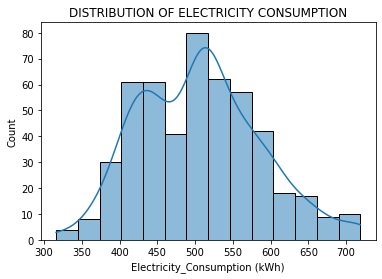

In [113]:
#PLOTTING HISTOGRAM TO CHECK THE DISTRIBUTION OF ELECTRICITY CONSUMPTION
sns.histplot(data= dist, x="Electricity_Consumption (kWh)", kde= True)
plt.title("DISTRIBUTION OF ELECTRICITY CONSUMPTION")
plt.show()

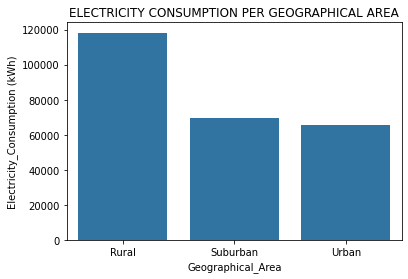

In [114]:
#CALCULATING THE SUM OF ELECTRICITY CONSUMPTION PER GEOGRAPHICAL AREA
Geographical_Area_Consumption= dist.groupby("Geographical_Area")["Electricity_Consumption (kWh)"].sum().reset_index()

#PLOTTING A BARCHART TO SHOW THE ELECTRICITY CONSUMPTION PER GEOGRAPHICAL AREA
sns.barplot(data= Geographical_Area_Consumption, x= "Geographical_Area", y="Electricity_Consumption (kWh)")
plt.title("ELECTRICITY CONSUMPTION PER GEOGRAPHICAL AREA")
plt.show()

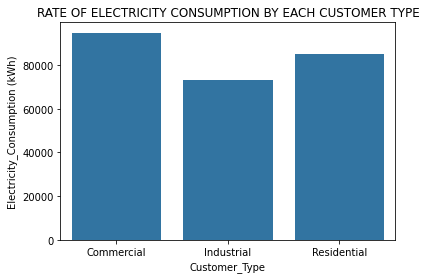

In [115]:
#CALCULATING THE SUM OF ELECTRICITY CONSUMPTION PER CUSTOMER TYPE
Customer_type_Consumption= dist.groupby("Customer_Type")["Electricity_Consumption (kWh)"].sum().reset_index()

#PLOTTING A BARCHART TO SHOW THE RATE OF ELECTRICITY CONSUMPTION BY EACH CUSTOMER TYPE
sns.barplot(data= Customer_type_Consumption, x= "Customer_Type", y="Electricity_Consumption (kWh)")
plt.title("RATE OF ELECTRICITY CONSUMPTION BY EACH CUSTOMER TYPE")
plt.show()

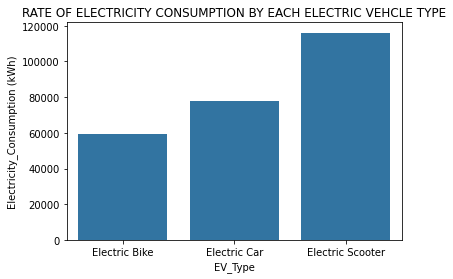

In [116]:
#CALCULATING THE SUM OF ELECTRICITY CONSUMPTION PER ELECTRIC VEHCLE TYPE
EV_Type_Consumption= dist.groupby("EV_Type")["Electricity_Consumption (kWh)"].sum().reset_index()

#PLOTTING A BARCHART TO SHOW THE RATE OF ELECTRICITY CONSUMPTION BY EACH ELECTRIC VEHCLE TYPE
sns.barplot(data=EV_Type_Consumption, x= "EV_Type", y="Electricity_Consumption (kWh)")
plt.title("RATE OF ELECTRICITY CONSUMPTION BY EACH ELECTRIC VEHCLE TYPE")
plt.show()

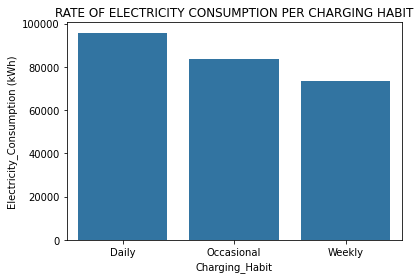

In [117]:
#CALCULATING THE SUM OF ELECTRICITY CONSUMPTION PER CHARGING HABIT
Charging_Habit_Consumption= dist.groupby("Charging_Habit")["Electricity_Consumption (kWh)"].sum().reset_index()

#PLOTTING A BARCHART TO SHOW THE RATE OF ELECTRICITY CONSUMPTION PER CHARGING HABIT
sns.barplot(data=Charging_Habit_Consumption, x= "Charging_Habit", y="Electricity_Consumption (kWh)")
plt.title("RATE OF ELECTRICITY CONSUMPTION PER CHARGING HABIT")
plt.show()

In [118]:
# Initialize the map, centered at the median location of all substations
map0 = folium.Map(
    location=[geo["Substation_latitude"].median(), geo["Substation_longitude"].median()],
    zoom_start=3)

# Add markers for each substation location
for loc, row in geo.iterrows():
    folium.CircleMarker(
        location=[row["Substation_latitude"], row["Substation_longitude"]],
        popup=row["Substation_Location"],  
        radius=5, 
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(Substation_map)

# Add markers for each electric vehicle charging station location
for loc, row in dist.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        popup=row["EV_Charging_Station_Location"],  
        radius=5,  
        color='green',
        fill=True,
        fill_color='green'
    ).add_to(map0)

# Display the map
map0


In [119]:
from folium import plugins

# Initialize the map, centered at the median location of all substations
map1 = folium.Map(
    location=[geo["Substation_latitude"].median(), geo["Substation_longitude"].median()],
    zoom_start=3)

# Add markers for each substation location
for loc, row in geo.iterrows():
    folium.CircleMarker(
        location=[row["Substation_latitude"], row["Substation_longitude"]],
        popup=row["Substation_Location"],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue').add_to(map1)

# Add markers for each electric vehicle charging station location
for loc, row in dist.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        popup=row["EV_Charging_Station_Location"],
        radius=5,
        color='green',
        fill=True,
        fill_color='green'
    ).add_to(map1)

# Add connection lines between each substation and electric vehicle charging station
for line, substation in geo.iterrows():
    for line, distribution in dist.iterrows():
        folium.PolyLine(
            locations=[
                [substation["Substation_latitude"], substation["Substation_longitude"]],
                [distribution["Latitude"], distribution["Longitude"]]
            ],
            color="gray",  # Color of the line
            weight=0.1,      # Line thickness
            opacity=0.5    # Line transparency
        ).add_to(map1)

# Display the map
map1


In [120]:
# Initialize the map, centered at the median location of all substations
map2 = folium.Map(
    location=[geo["Substation_latitude"].median(), geo["Substation_longitude"].median()],
    zoom_start=3)

#Adding a marker for the specific substation
substation = geo.iloc[0] 
folium.CircleMarker(
    location=[substation["Substation_latitude"], substation["Substation_longitude"]],
    popup=substation["Substation_Location"],
    radius=5,
    color='blue',
    fill=True,
    fill_color='blue').add_to(map2)

#Adding a marker for the specific electric vehicle charging station
distribution = dist.iloc[0]  
folium.CircleMarker(
    location=[distribution["Latitude"], distribution["Longitude"]],
    popup=distribution["EV_Charging_Station_Location"],
    radius=5,
    color='green',
    fill=True,
    fill_color='green').add_to(map2)

# Draw a single connection line between the selected substation and electric vehicle charging station
folium.PolyLine(
    locations=[
        [substation["Substation_latitude"], substation["Substation_longitude"]],
        [distribution["Latitude"], distribution["Longitude"]]],
    color="red",  # Customize color for visibility
    weight=3,     # Line thickness
    opacity=0.7   # Line transparency
).add_to(map2)

# Display the map
map2


In [121]:
# Initialize the map, centered at the median location of all substations
map3 = folium.Map(
    location=[geo["Substation_latitude"].median(), geo["Substation_longitude"].median()],
    zoom_start=3)

#Adding a marker for the specific substation
substation = geo.iloc[20]  # Select the first row in geo
folium.CircleMarker(
    location=[substation["Substation_latitude"], substation["Substation_longitude"]],
    popup=substation["Substation_Location"],
    radius=5,
    color='blue',
    fill=True,
    fill_color='blue').add_to(map3)

#Adding a marker for the specific distribution point
distribution = dist.iloc[20]  # Select the first row in dist
folium.CircleMarker(
    location=[distribution["Latitude"], distribution["Longitude"]],
    popup=distribution["EV_Charging_Station_Location"],
    radius=5,
    color='green',
    fill=True,
    fill_color='green').add_to(map3)

# Draw a single connection line between the selected substation and electric vehicle charging station
folium.PolyLine(
    locations=[
        [substation["Substation_latitude"], substation["Substation_longitude"]],
        [distribution["Latitude"], distribution["Longitude"]]],
    color="red",  # Customize color for visibility
    weight=3,     # Line thickness
    opacity=0.7   # Line transparency
).add_to(map3)

# Display the map
map3


In [122]:
# Initialize the map, centered at the median location of all substations
map4 = folium.Map(
    location=[geo["Substation_latitude"].median(), geo["Substation_longitude"].median()],
    zoom_start=5)

#Adding a marker for the specific substation
substation = geo.iloc[49]  
folium.CircleMarker(
    location=[substation["Substation_latitude"], substation["Substation_longitude"]],
    popup=substation["Substation_Location"],
    radius=5,
    color='blue',
    fill=True,
    fill_color='blue').add_to(map4)

#Adding a marker for the specific distribution point
distribution = dist.iloc[49] 
folium.CircleMarker(
    location=[distribution["Latitude"], distribution["Longitude"]],
    popup=distribution["EV_Charging_Station_Location"],
    radius=5,
    color='green',
    fill=True,
    fill_color='green').add_to(map4)

# Draw a single connection line between the selected substation and electric vehicle charging station
folium.PolyLine(
    locations=[
        [substation["Substation_latitude"], substation["Substation_longitude"]],
        [distribution["Latitude"], distribution["Longitude"]]
    ],
    color="red",  # Customize color for visibility
    weight=3,     # Line thickness
    opacity=0.7   # Line transparency
).add_to(map4)

# Display the map
map4


## NETWORK CAPACITY ANALYSIS

In [123]:
#CALCULATING THE SUM OF ELECTRICITY CONSUMPTION PER SUBSTATION ID
substation_total_consumption =dist.groupby("Substation_ID")["Electricity_Consumption (kWh)"].sum().reset_index()

#MERGING YHE GEOSPATIAL DATA WITH SUBSTATION TOTAL CONSUMPTION
network_capacity=pd.merge(geo,substation_total_consumption, on= "Substation_ID")

#Renaming Electricity_Consumption (kWh)": "Total_electricity_consumption(kWh)
network_capacity.rename(columns={"Electricity_Consumption (kWh)": "Total_electricity_consumption(kWh)"}, inplace= True)
network_capacity.head()

,Substation_ID,Substation_Location,Transmission_Line_Capacity (MW),Substation_latitude,Substation_longitude,Total_electricity_consumption(kWh)
0,Substation_907,"(57.25813554648914, -70.90582041775649)",40,57.258136,-70.905820,6663.768920
1,Substation_218,"(70.02538473360673, -84.38057237161145)",71,70.025385,-84.380572,5997.437051
2,Substation_339,"(80.39323542610704, -75.79784143914193)",85,80.393235,-75.797841,4536.778685
3,Substation_773,"(49.12307771334813, -87.3598904388042)",10,49.123078,-87.359890,4426.337993
4,Substation_349,"(66.79887060665365, -86.51124108848195)",40,66.798871,-86.511241,4901.836555


In [124]:
#CALCULATING THE CONSUMPTION TO CAPACITY RATIO 
network_capacity["Consumption_to_capacity_ratio"]= network_capacity["Total_electricity_consumption(kWh)"] / (network_capacity["Transmission_Line_Capacity (MW)"]*1000)
network_capacity.head()

,Substation_ID,Substation_Location,Transmission_Line_Capacity (MW),Substation_latitude,Substation_longitude,Total_electricity_consumption(kWh),Consumption_to_capacity_ratio
0,Substation_907,"(57.25813554648914, -70.90582041775649)",40,57.258136,-70.905820,6663.768920,0.166594
1,Substation_218,"(70.02538473360673, -84.38057237161145)",71,70.025385,-84.380572,5997.437051,0.084471
2,Substation_339,"(80.39323542610704, -75.79784143914193)",85,80.393235,-75.797841,4536.778685,0.053374
3,Substation_773,"(49.12307771334813, -87.3598904388042)",10,49.123078,-87.359890,4426.337993,0.442634
4,Substation_349,"(66.79887060665365, -86.51124108848195)",40,66.798871,-86.511241,4901.836555,0.122546


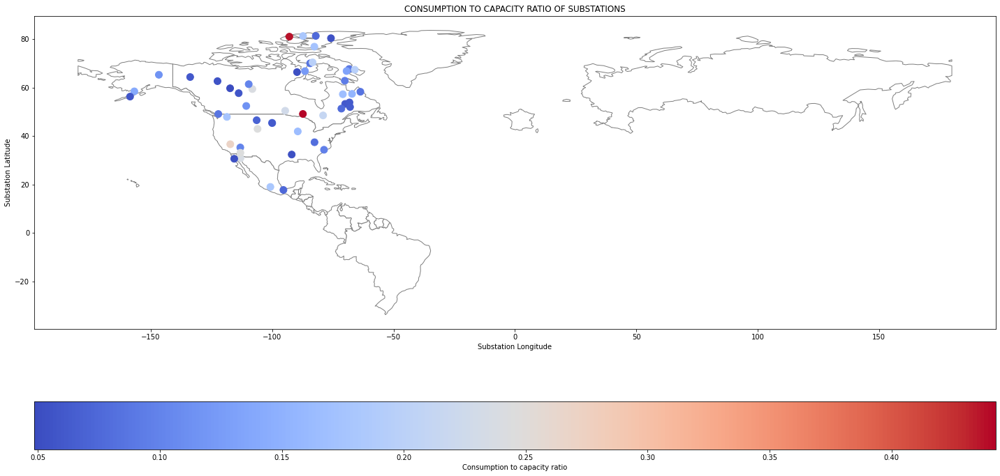

In [125]:
from shapely.geometry import Point, box

#GENERATE GEOMETRIIES FOR SUBSTATION
geometry_network_capacity=[Point(lon, lat) for lon, lat in zip(network_capacity["Substation_longitude"], network_capacity["Substation_latitude"])]

#TRANSFORME THE DATASET TO A GEODATAFRAME FOR GEOPANDAS READABILITY
gpd_network_capacity= gpd.GeoDataFrame(network_capacity, geometry= geometry_network_capacity)

#FILTERING THE MAP TO FOCUS ON NORTH AMERICA 
world = gpd.read_file(r"C:\Users\TOMORI\Downloads\ne_110m_admin_0_countries\ne_110m_admin_0_countries.shx")
north_america_bbox = box(-170, 5, -30, 85)
north_america = world[world.geometry.intersects(north_america_bbox)]

#PLOTTING THE MAP
fig, ax= plt.subplots(figsize=(20, 10))
north_america.plot(ax=ax, color= "white", edgecolor= "gray")
gpd_network_capacity.plot(column= "Consumption_to_capacity_ratio", cmap="coolwarm", legend= True,
                         marker= "o", markersize= 100, ax=ax, legend_kwds={"label": "Consumption to capacity ratio", "orientation": "horizontal"})

ax.set_title('CONSUMPTION TO CAPACITY RATIO OF SUBSTATIONS')
ax.set_xlabel('Substation Longitude')
ax.set_ylabel('Substation Latitude')
plt.tight_layout()
plt.show()

 The above map shows that majority of the substation are nearing capacity overloading or are overloaded

In [126]:
#CALCULATING THE TOTAL NUMBER OF EVs IN EACH SUBSTATION
total_ev= dist.groupby("Substation_ID")["Number_of_EVs"].sum().reset_index()

#MERGING THE TOTAL EVs TO THE NETWORK CAPACITY DATASET
ev_capacity= pd.merge(network_capacity, total_ev, on= "Substation_ID")

#CHECKING THE CORRELATION BETWEEN CONSUMPTION TO CAPACITY RATIO AND TOTAL NUMBER OF EVs
ev_capacity["Number_of_EVs"].corr(ev_capacity["Consumption_to_capacity_ratio"])

-0.10944923035990642

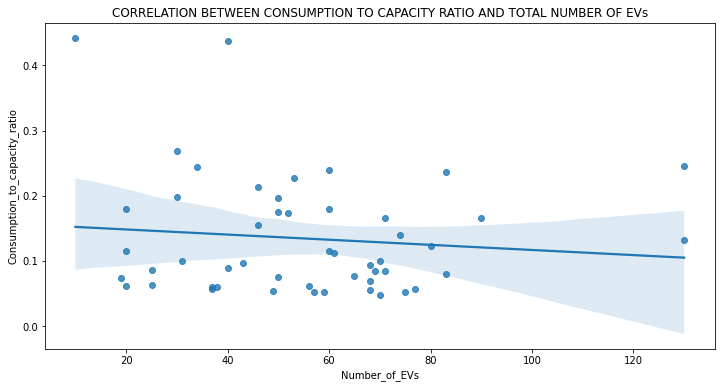

In [127]:
#VISUALIZING THE CORRELATION
plt.figure(figsize=(12, 6))
sns.regplot(data= ev_capacity, x="Number_of_EVs", y= "Consumption_to_capacity_ratio")
plt.title("CORRELATION BETWEEN CONSUMPTION TO CAPACITY RATIO AND TOTAL NUMBER OF EVs")
plt.show()

This regression plot shows that there is no correlation between consumption to capacity ratio and the total numbers of EVs in each substation. This means that number of Evs didn't cause electricity overload

## BOTTLENECKS IDENTIFICATION

In [128]:
#CHECKING FOR THE CONSUMPTION TO CAPACITY RATIO GREATER THAN OR EQUALS TO 0.8
bottleneck_substation= network_capacity[network_capacity["Consumption_to_capacity_ratio"]>=0.8]
bottleneck_substation

,Substation_ID,Substation_Location,Transmission_Line_Capacity (MW),Substation_latitude,Substation_longitude,Total_electricity_consumption(kWh),Consumption_to_capacity_ratio


This shows that the substations are not overloaded but they are  getting there

In [129]:
#MERGING THE DISTRIBUTION DATA WITH THE WEATHER DATA
df=pd.merge(dist, weather, on= ["Substation_ID", "Timestamp"])
df.head()

,Timestamp,Geographical_Area,Customer_Type,Electricity_Consumption (kWh),EV_Charging_Station_Location,EV_Charging_Station_Specifications,EV_Type,Charging_Habit,Number_of_EVs,Substation_ID,Latitude,Longitude,Temperature (°C),Precipitation (mm),Weather_Conditions
0,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964,17.726056,2.938451,Rainy
1,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907,48.447827,-71.988591,31.150853,4.032014,Clear
2,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964,17.726056,2.938451,Rainy
3,2020-01-22 17:00:00,Rural,Residential,554.336019,"(48.447826648452946, -71.98859080823637)",Type 2,Electric Scooter,Weekly,5,Substation_907,48.447827,-71.988591,31.150853,4.032014,Clear
4,2020-01-10 18:00:00,Urban,Industrial,714.394409,"(64.01943603679787, -129.53196438913122)",Type 2,Electric Car,Occasional,8,Substation_907,64.019436,-129.531964,17.726056,2.938451,Rainy


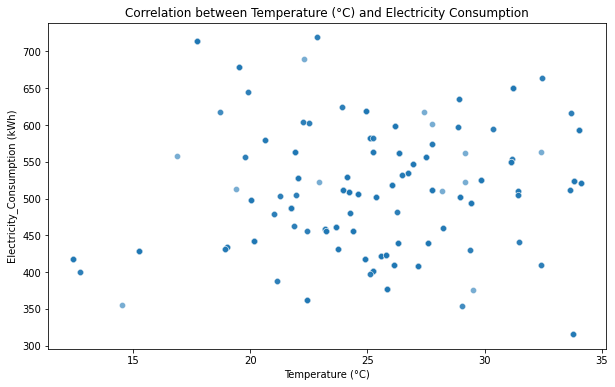

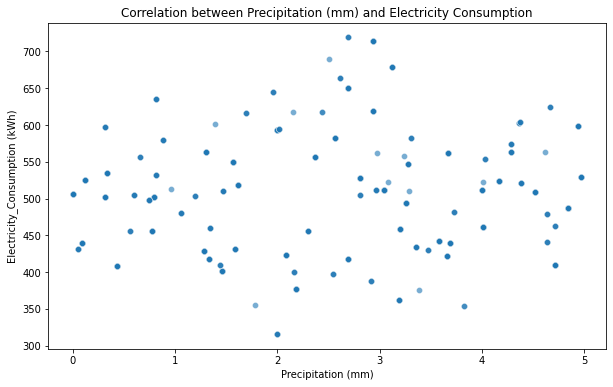

In [130]:
#PLOT SHOWING THE CORRELATION BETWEEN TEMPERATURE AND ELECTRICITY CONSUMPTION
plt.figure(figsize=(10, 6))
sns.scatterplot(data= df, x="Temperature (°C)", y= "Electricity_Consumption (kWh)", alpha=0.6)
plt.title("Correlation between Temperature (°C) and Electricity Consumption")
plt.show()

#PLOT SHOWING THE CORRELATION BETWEEN TEMPERATURE AND ELECTRICITY CONSUMPTION
plt.figure(figsize=(10, 6))
sns.scatterplot(data= df, x= "Precipitation (mm)", y= "Electricity_Consumption (kWh)", alpha=0.6)
plt.title("Correlation between Precipitation (mm) and Electricity Consumption")
plt.show()

This shows that there is no relationship between the weather dataset and the Electricity consumption

## INSIGHTS 

After analysing our dataset, it showed the following insights;
- The amount of electricity consumption mostly used is 500kw/hr
- Rural areas consumed more electricity than other areas
- Among all the electric vehicle types, electric scooter consumed the highest electricity
- The charging habit also showed that people tends to recharge daily
- the electric charging stations are evenly distributed in North America but their substaions are far from them and they are not much
- The substaions are not yet overload but they have potential in getting oveloaded
- The number of electric vehicle, temperature and precipitation are not factors that can cause electricity overload

## RECOMMENDATIONS

Based on the insights gotten from the datasets, the following suggestions were made;
- Optimize Distribution of Charging Stations and Substations: 
   - Since substations are located far from electric charging stations, it may be beneficial to build additional substations closer to these stations to improve efficiency and reduce transmission losses. This will also help reduce potential overload risks as electric vehicle usage grows.
   - Consider adding more charging stations in areas with higher consumption, particularly in rural regions, to meet demand and avoid congestion at existing stations but also consider the cost analysis to know which kind of upgrade to do.
   
- Conduct Periodic Load Assessments for Substations:
     - Although substations aren’t overloaded now, regularly checking and tracking their load can help spot and prevent possible overloads in the future. Creating prediction models based on the growth of electric vehicle use and local electricity consumption can help prepare for future increases in demand and avoid overloads.
     
- Further Study on Environmental Impact:
    - Since temperature and precipitation don’t seem to impact electricity overload, considering future climate impacts that might influence energy demand such as extreme temperatures or heavy rainfall